<a href="https://colab.research.google.com/github/bumbum2403/AtlantaSys/blob/main/License_Plate_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [30]:

!pip install opencv-python-headless -q

# EasyOCR: For optical character recognition (extracting text from images)
!pip install easyocr -q

# Ultralytics: For YOLO object detection models (specifically YOLOv8 for plate detection)
# This will also install PyTorch and other dependencies.
!pip install ultralytics -q

# Matplotlib: For displaying images (often pre-installed in Colab but good to ensure)
!pip install matplotlib -q

# Numpy: For numerical operations (fundamental package for scientific computing)
!pip install numpy -q

print("--- Libraries Installation Complete ---")

import cv2
import easyocr
from ultralytics import YOLO
import matplotlib.pyplot as plt
import numpy as np
import os # For file system operations

print("--- Libraries Import Complete ---")

# --- Verify versions (optional but good for debugging) ---
print(f"OpenCV version: {cv2.__version__}")
import torch
print(f"PyTorch version: {torch.__version__}")
print(f"Ultralytics YOLO version: Check YOLO() model load") # Version is not directly available like others
import easyocr as ocr_version_check
# EasyOCR doesn't have a simple __version__ attribute easily accessible after import this way
# but installation success implies it's ready.

print("\nSetup complete! You can now proceed to the next steps.")

--- Libraries Installation Complete ---
--- Libraries Import Complete ---
OpenCV version: 4.11.0
PyTorch version: 2.6.0+cu124
Ultralytics YOLO version: Check YOLO() model load

Setup complete! You can now proceed to the next steps.


In [31]:
# Cell 2: Mount Google Drive, Unzip Dataset, and Parse Annotations (Revised)

from google.colab import drive
import os
import zipfile
import xml.etree.ElementTree as ET # For parsing XML files

# 1. Mount Google Drive
print("Mounting Google Drive...")
drive.mount('/content/drive')
print("Google Drive mounted.")

# 2. Define the path to your Kaggle dataset zip file
zip_file_path = '/content/drive/MyDrive/Datasets/indian-vehicle-dataset.zip' # <--- IMPORTANT: Adjust this path!

# 3. Define the directory where you want to extract the dataset
extract_dir = '/content/datasets/indian_vehicle_dataset'

# Create the extraction directory if it doesn't exist
os.makedirs(extract_dir, exist_ok=True)

# 4. Unzip the dataset if not already unzipped
print(f"\nUnzipping '{zip_file_path}' to '{extract_dir}'...")
if os.path.exists(zip_file_path) and not os.path.exists(os.path.join(extract_dir, 'State-wise_OLX', 'DL')): # Simple check if already unzipped
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall(extract_dir)
    print("Dataset unzipped successfully!")
else:
    print("Dataset already unzipped or zip file not found. Skipping unzipping.")

print(f"Contents of the extracted dataset ({extract_dir}):")
for item in os.listdir(extract_dir):
    print(f"- {item}")

# --- New: Function to parse XML annotation files ---
def parse_xml_annotation(xml_file_path):
    """
    Parses a single XML annotation file and extracts bounding box and license number.
    Returns a list of dicts, as an image might have multiple plates (though rare for this dataset).
    """
    tree = ET.parse(xml_file_path)
    root = tree.getroot()

    annotations = []

    # Iterate through all 'object' tags, as each might represent a license plate
    for obj in root.findall('object'):
        name = obj.find('name').text # This is the license plate number
        bndbox = obj.find('bndbox')
        xmin = int(bndbox.find('xmin').text)
        ymin = int(bndbox.find('ymin').text)
        xmax = int(bndbox.find('xmax').text)
        ymax = int(bndbox.find('ymax').text)

        annotations.append({
            'name': name,
            'box': [xmin, ymin, xmax, ymax]
        })
    return annotations

# --- New: Collect image and annotation paths ---
all_image_data = [] # List to store dicts: {'image_path': ..., 'annotations': [...]}

# Define the folders to scan for images and XMLs
# Adjust these based on your preference for which parts of the dataset to use
folders_to_scan = [
    os.path.join(extract_dir, 'google-images'),
    os.path.join(extract_dir, 'video_images'),
    # You can add specific state folders or iterate through all states
    os.path.join(extract_dir, 'State-wise_OLX', 'DL'),
    os.path.join(extract_dir, 'State-wise_OLX', 'MH'),
    os.path.join(extract_dir, 'State-wise_OLX', 'UP'),
    os.path.join(extract_dir, 'State-wise_OLX', 'KA'), # Adding another state
    os.path.join(extract_dir, 'State-wise_OLX', 'TN') # Adding another state
]

print("\nCollecting image and annotation data...")
for folder_path in folders_to_scan:
    if not os.path.isdir(folder_path):
        print(f"Warning: Image folder '{folder_path}' not found. Skipping.")
        continue

    for filename in os.listdir(folder_path):
        if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
            image_path = os.path.join(folder_path, filename)
            # Corresponding XML file should have the same base name but with .xml extension
            xml_filename = os.path.splitext(filename)[0] + '.xml'
            xml_path = os.path.join(folder_path, xml_filename)

            if os.path.exists(xml_path):
                annotations = parse_xml_annotation(xml_path)
                if annotations: # Only add if annotations were found
                    all_image_data.append({
                        'image_path': image_path,
                        'annotations': annotations
                    })
                else:
                    print(f"Warning: No license plate objects found in XML for {image_path}")
            else:
                print(f"Warning: XML annotation file not found for {image_path}. Skipping.")

print(f"Collected data for {len(all_image_data)} images with annotations.")
if not all_image_data:
    print("No annotated images found. Please check dataset structure and XML presence.")

print("\n--- Dataset and Annotation Parsing Complete ---")

Mounting Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Google Drive mounted.

Unzipping '/content/drive/MyDrive/Datasets/indian-vehicle-dataset.zip' to '/content/datasets/indian_vehicle_dataset'...
Dataset already unzipped or zip file not found. Skipping unzipping.
Contents of the extracted dataset (/content/datasets/indian_vehicle_dataset):
- google_images
- State-wise_OLX
- video_images

Collected data for 767 images with annotations.

--- Dataset and Annotation Parsing Complete ---


In [32]:
# Cell 3: License Plate Detection Function (using YOLOv8)

from ultralytics import YOLO

# Load a pre-trained YOLOv8 model (e.g., yolov8n.pt for general object detection)
# In a real ANPR system, you would fine-tune a YOLOv8 model on a custom Indian license plate dataset
# or use a model specifically trained for license plate detection.
model = YOLO('yolov8n.pt') # 'n' for nano, a small and fast model

def detect_license_plate(image_path):
    """
    Detects license plates in an image using YOLOv8.

    Args:
        image_path (str): Path to the input image.

    Returns:
        list: A list of dictionaries, each containing 'box' (bounding box
              coordinates [x1, y1, x2, y2]) and 'score' for detected plates.
        numpy.ndarray: The original image loaded by OpenCV.
    """
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error: Could not load image from {image_path}")
        return [], None

    # Perform inference
    # Note: For accurate license plate detection, a YOLO model specifically
    # trained on license plates is recommended. Here, we're using a general
    # object detection model and might filter by class if 'car' or 'license_plate'
    # is available.
    results = model(img)

    detected_plates = []
    for r in results:
        boxes = r.boxes # Bounding box objects
        for box in boxes:
            # Assuming 'license_plate' is a detected class, or if not,
            # we'll look for general rectangular objects that might be plates.
            # In a real scenario, you'd check `model.names[int(box.cls)]` for 'license_plate' class.

            # For simplicity in this demo, let's just get any detected object
            # and treat its bounding box as a potential license plate for OCR.
            # This is a simplification and would need refinement for production.
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
            score = round(float(box.conf[0]), 2)

            # You might want to filter by class here if your model has a 'license_plate' class
            # For example: if model.names[int(box.cls)] == 'license_plate':
            # This general model (yolov8n.pt) might detect 'car', 'truck', etc.
            # We'll proceed with any detected box for demonstration.

            detected_plates.append({'box': [x1, y1, x2, y2], 'score': score})

    return detected_plates, img

print("License plate detection function defined.")

License plate detection function defined.


In [33]:
# Cell 4: Character Recognition Function (using EasyOCR) - REVERTED TO PREVIOUS WORKING VERSION

import easyocr
import cv2
import numpy as np

# Initialize EasyOCR reader once.
# 'en' for English language models, as Indian license plates use English characters and numbers.
reader = easyocr.Reader(['en'])
print("EasyOCR reader initialized.")

def recognize_characters(image_crop):
    """
    Recognizes alphanumeric characters from a cropped image of a license plate.

    Args:
        image_crop (numpy.ndarray): The cropped image containing the license plate.

    Returns:
        str: The recognized and cleaned text from the license plate.
    """
    if image_crop is None or image_crop.size == 0:
        print("Warning: Empty image crop passed to recognize_characters.")
        return ""

    # EasyOCR works directly on NumPy arrays (OpenCV images).
    # We are now NOT doing aggressive preprocessing here.

    # Perform OCR
    # detail=0 returns just the text, detail=1 returns (bbox, text, score)
    # Using allowlist to restrict to alphanumeric might still be a good idea,
    # as it doesn't modify the image pixels but filters OCR output.
    results = reader.readtext(image_crop, detail=0, allowlist='ABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789')

    recognized_text = " ".join(results) # Join all recognized text parts

    # Simple post-processing to clean the text:
    # 1. Remove common non-alphanumeric characters that might be misrecognized (e.g., -, ., /)
    # 2. Convert to uppercase for standardization
    # 3. Remove spaces for a compact plate number

    # A more robust cleaning would involve mapping common OCR errors (e.g., 'O' to '0', 'I' to '1')
    # based on Indian plate formats.
    cleaned_text = ""
    for char in recognized_text:
        if char.isalnum(): # Keep only alphanumeric characters
            cleaned_text += char

    # Basic heuristic corrections (less aggressive than before, can be refined)
    cleaned_text = cleaned_text.replace('O', '0') # Letter O mistaken for Zero 0
    cleaned_text = cleaned_text.replace('I', '1') # Letter I mistaken for One 1
    # Add more very common ones if you notice them consistently

    return cleaned_text.upper() # Convert to uppercase


EasyOCR reader initialized.


Proceeding with 767 annotated images from Cell 2.

Processing 10 randomly selected images for demonstration.

--- Processing Image 1/10: video11_1900.jpg ---
Ground Truth Plate(s) for this image: ['MH47Y1124']


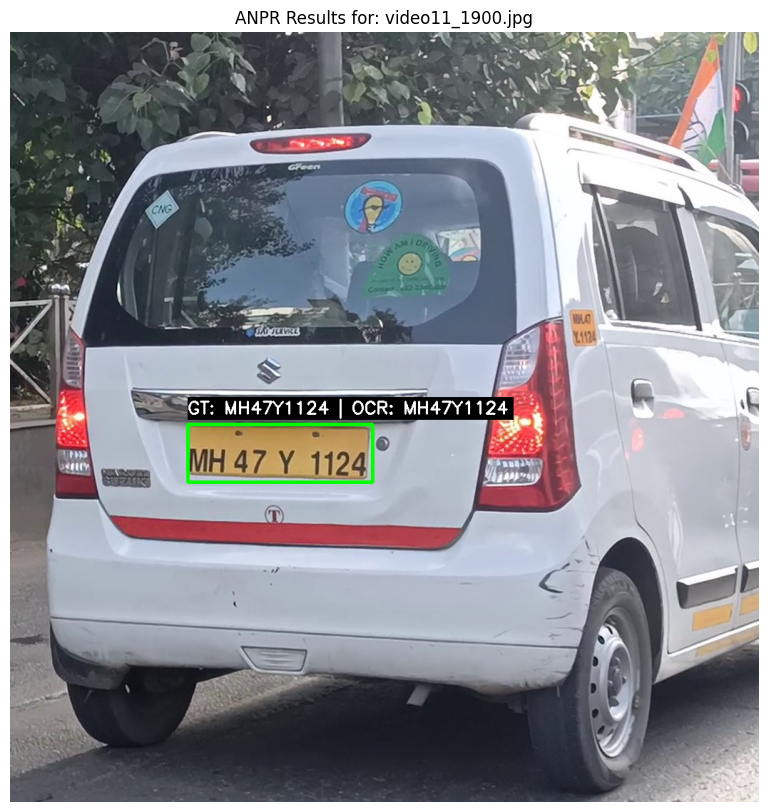

Recognition Details:
  - Ground Truth: 'MH47Y1124'
  - Recognized  : 'MH47Y1124'
  - Status      : EXACT MATCH
------------------------------

--- Processing Image 2/10: video8_1090.jpg ---
Ground Truth Plate(s) for this image: ['MH03AM3025']


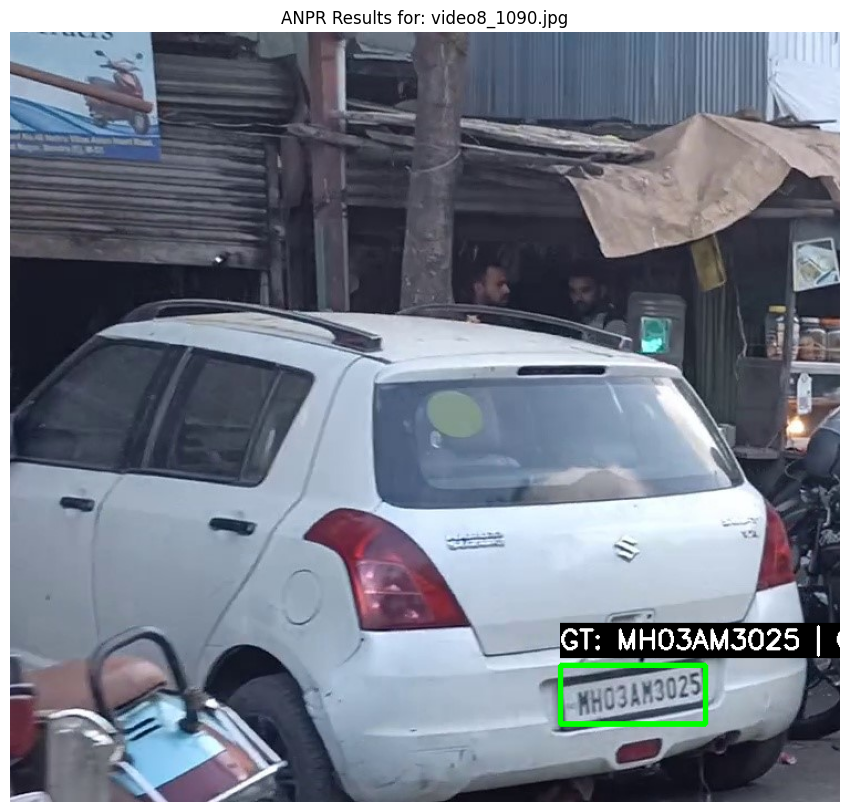

Recognition Details:
  - Ground Truth: 'MH03AM3025'
  - Recognized  : 'HH03442025'
  - Status      : MISMATCH
  - CER         : 0.40
------------------------------

--- Processing Image 3/10: video3_2210.jpg ---
Ground Truth Plate(s) for this image: ['MH02BT6482']


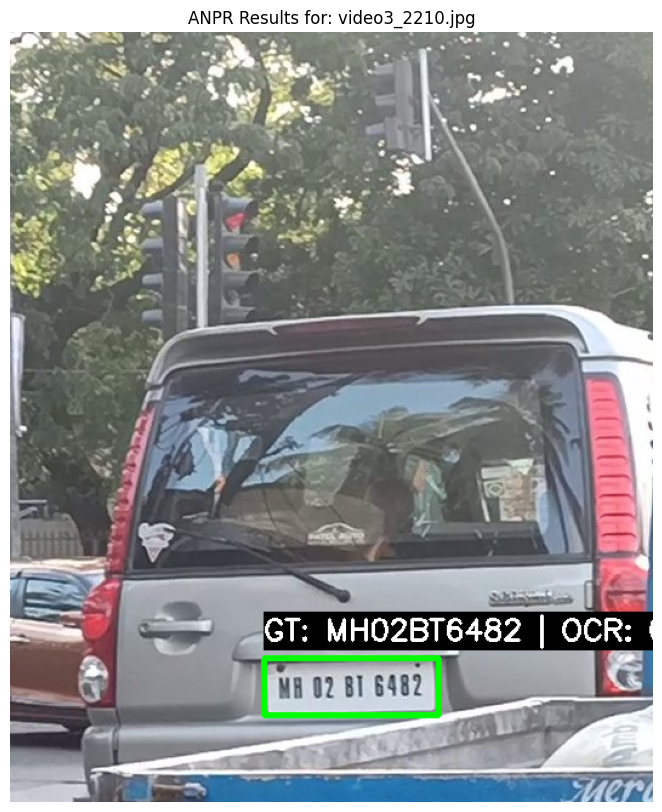

Recognition Details:
  - Ground Truth: 'MH02BT6482'
  - Recognized  : '02BT6482'
  - Status      : MISMATCH
  - CER         : 0.20
------------------------------

--- Processing Image 4/10: video11_2710.jpg ---
Ground Truth Plate(s) for this image: ['MH03BS4060']


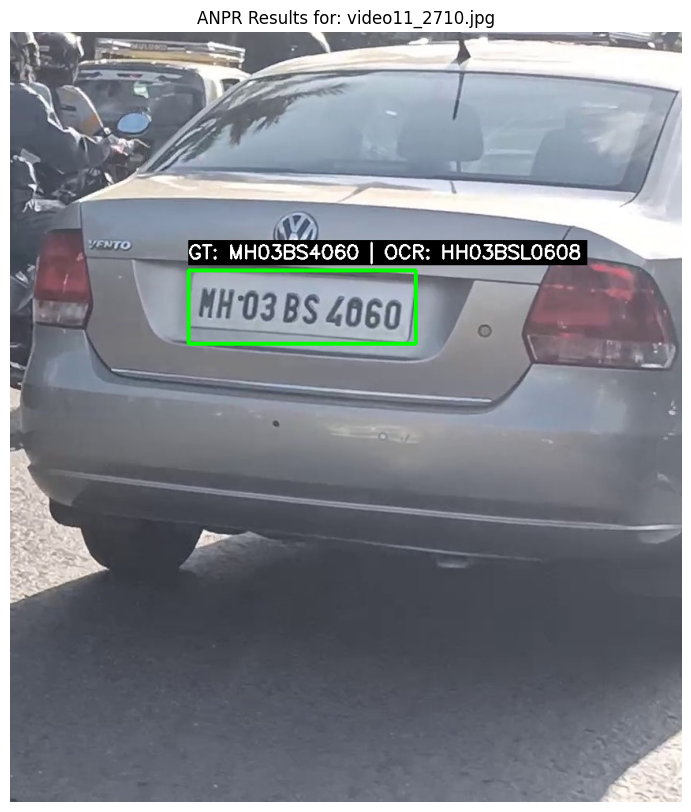

Recognition Details:
  - Ground Truth: 'MH03BS4060'
  - Recognized  : 'HH03BSL0608'
  - Status      : MISMATCH
  - CER         : 0.30
------------------------------

--- Processing Image 5/10: video3_1080.jpg ---
Ground Truth Plate(s) for this image: ['MH02EE8407']


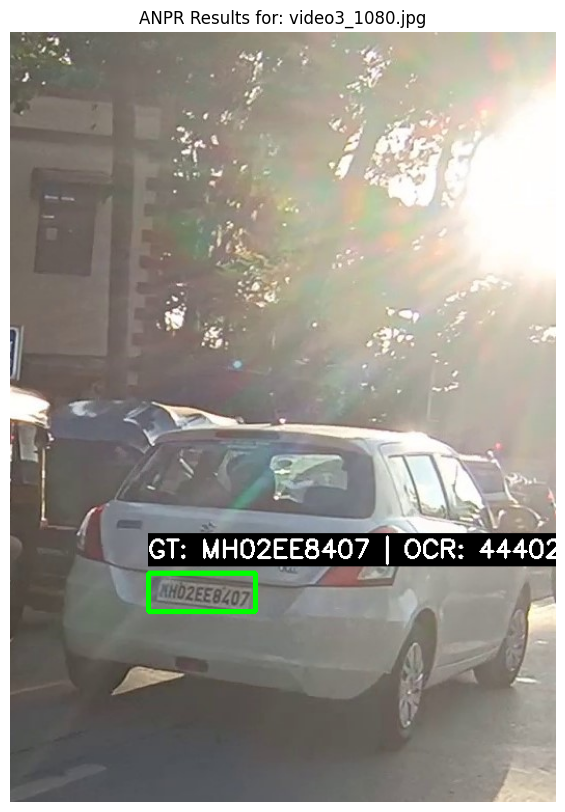

Recognition Details:
  - Ground Truth: 'MH02EE8407'
  - Recognized  : '44402E28407'
  - Status      : MISMATCH
  - CER         : 0.40
------------------------------

--- Processing Image 6/10: video11_800.jpg ---
Ground Truth Plate(s) for this image: ['MH01AX3070']


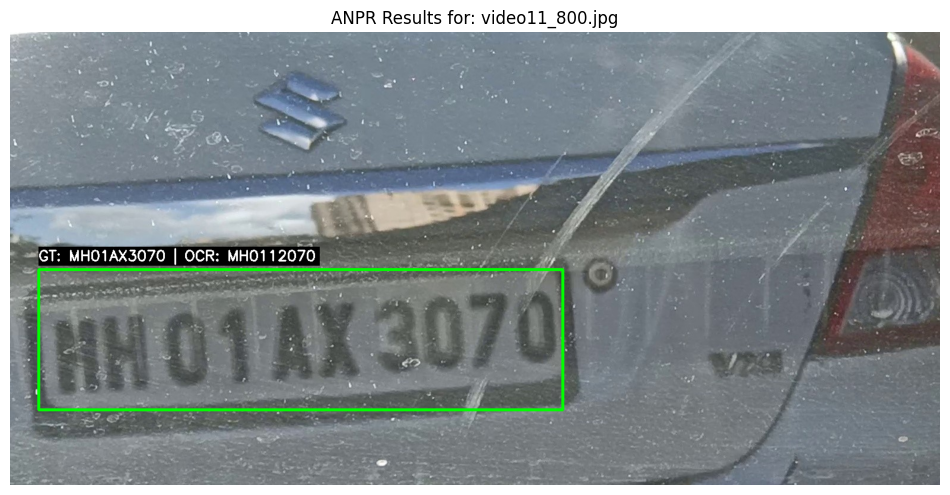

Recognition Details:
  - Ground Truth: 'MH01AX3070'
  - Recognized  : 'MH0112070'
  - Status      : MISMATCH
  - CER         : 0.30
------------------------------

--- Processing Image 7/10: car-ybs-MH47N4570_00000.png ---
Ground Truth Plate(s) for this image: ['MH47N4570']


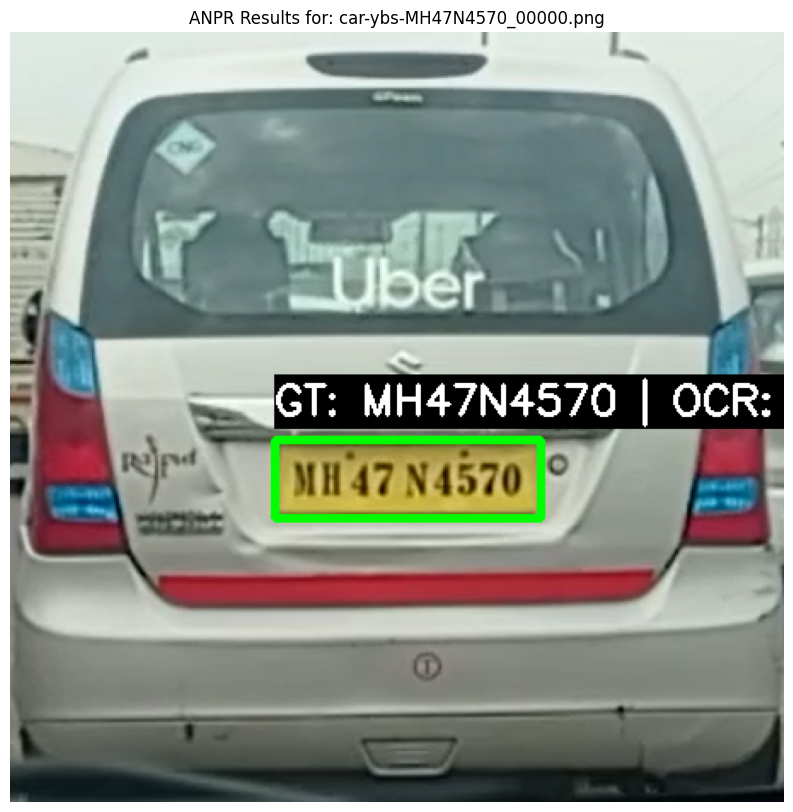

Recognition Details:
  - Ground Truth: 'MH47N4570'
  - Recognized  : 'MH47N4570'
  - Status      : EXACT MATCH
------------------------------

--- Processing Image 8/10: video11_3300.jpg ---
Ground Truth Plate(s) for this image: ['MH05DK1018']


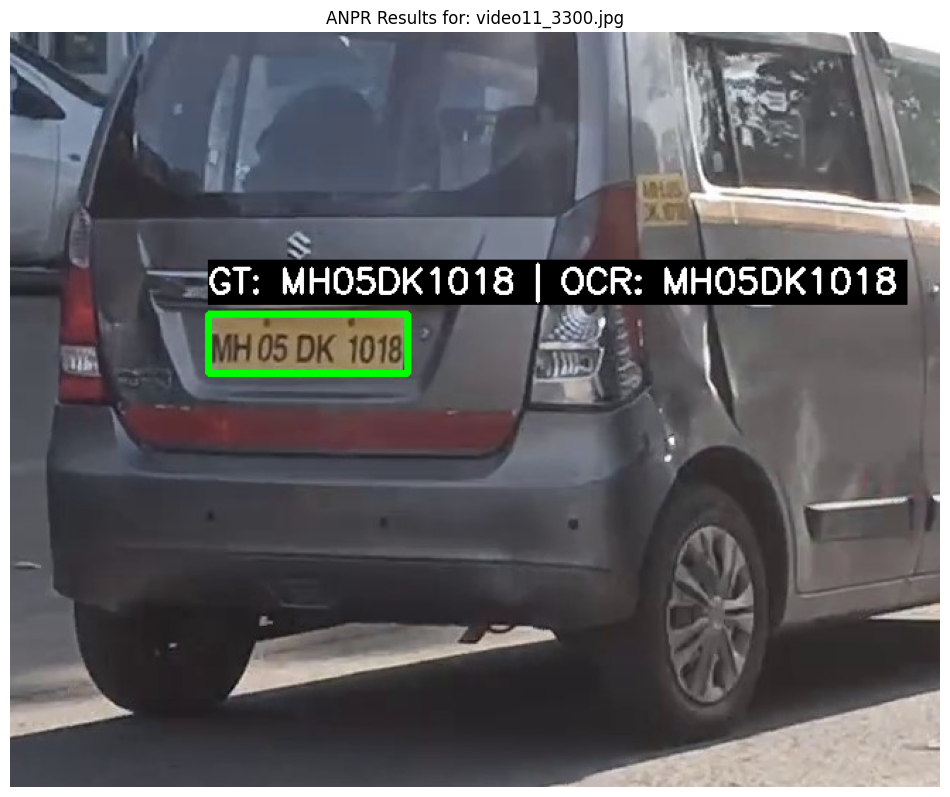

Recognition Details:
  - Ground Truth: 'MH05DK1018'
  - Recognized  : 'MH05DK1018'
  - Status      : EXACT MATCH
------------------------------

--- Processing Image 9/10: video11_3870.jpg ---
Ground Truth Plate(s) for this image: ['MH02DZ9898']


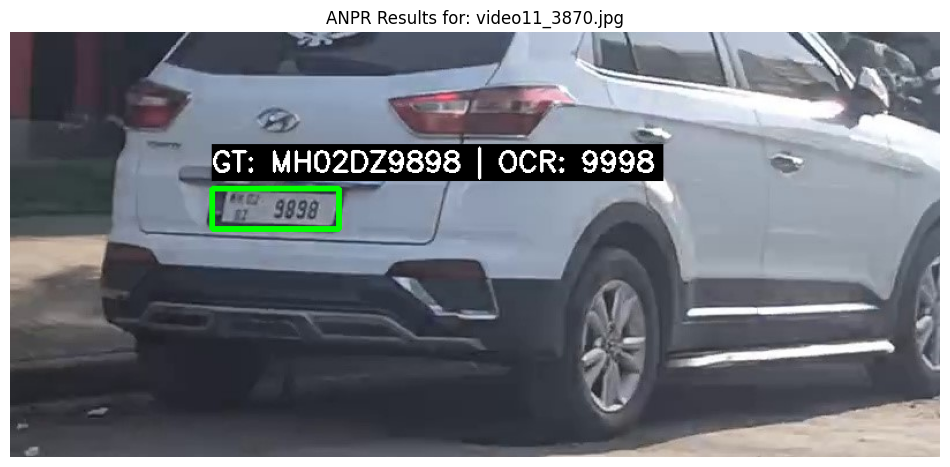

Recognition Details:
  - Ground Truth: 'MH02DZ9898'
  - Recognized  : '9998'
  - Status      : MISMATCH
  - CER         : 0.70
------------------------------

--- Processing Image 10/10: video5_500.jpg ---
Ground Truth Plate(s) for this image: ['MH03CS6266']


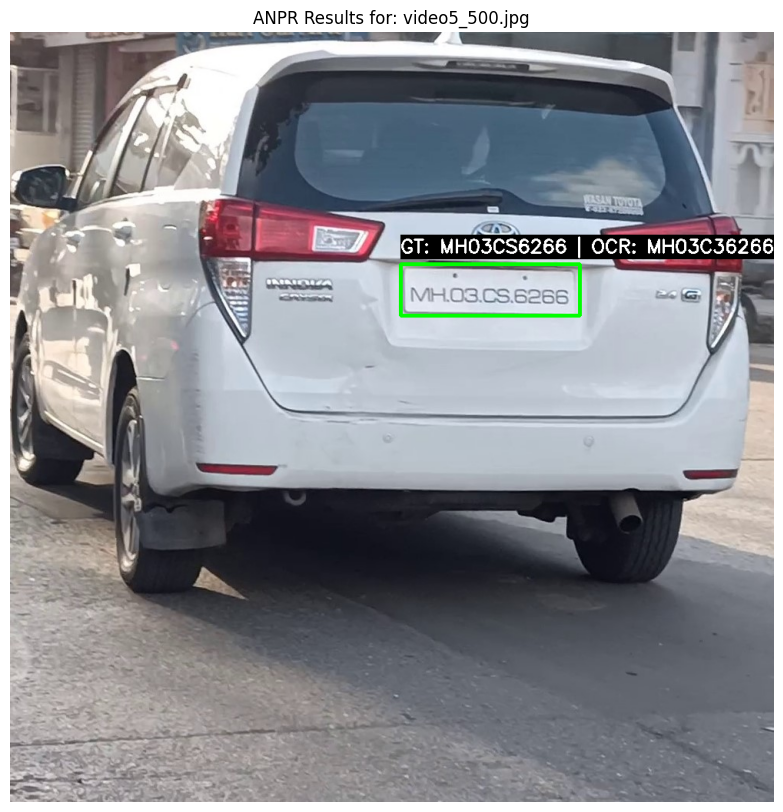

Recognition Details:
  - Ground Truth: 'MH03CS6266'
  - Recognized  : 'MH03C36266'
  - Status      : MISMATCH
  - CER         : 0.10
------------------------------

--- All Sample Images Processed ---
This demonstration uses ground truth bounding boxes for 'perfect' detection,
allowing us to evaluate and showcase the OCR performance more accurately.
For a full production system, the detection component would be a fine-tuned YOLO model.


In [34]:
# Cell 5: Main Processing Logic and Visualization (Using Ground Truth Annotations for Detection)
!pip install python-Levenshtein -q

import cv2
import matplotlib.pyplot as plt
import numpy as np
import random # To select a random subset of images

# Ensure all_image_data list is populated from Cell 2
if 'all_image_data' not in locals() or not all_image_data:
    print("Error: 'all_image_data' not found or is empty. Please run Cell 2 first.")
    # Exit or handle error appropriately if running as a script
    # For Colab, a print statement is usually enough.
else:
    print(f"Proceeding with {len(all_image_data)} annotated images from Cell 2.")

# --- Select a subset of images for demonstration ---
# We'll pick a few random images to ensure variety.
num_demo_images = 10 # Process 10 images for demo. Adjust as needed.
if len(all_image_data) > num_demo_images:
    demo_images = random.sample(all_image_data, num_demo_images)
else:
    demo_images = all_image_data # Use all if less than num_demo_images

print(f"\nProcessing {len(demo_images)} randomly selected images for demonstration.")

# --- Main processing loop ---
for i, image_info in enumerate(demo_images):
    image_path = image_info['image_path']
    ground_truth_annotations = image_info['annotations']

    print(f"\n--- Processing Image {i+1}/{len(demo_images)}: {os.path.basename(image_path)} ---")
    print(f"Ground Truth Plate(s) for this image: {[ann['name'] for ann in ground_truth_annotations]}")

    original_img = cv2.imread(image_path)
    if original_img is None:
        print(f"Error: Could not load image from {image_path}. Skipping.")
        continue

    display_img = original_img.copy()
    img_height, img_width, _ = display_img.shape

    recognized_plates_info = []

    # Iterate through each annotated license plate in the image
    for gt_ann in ground_truth_annotations:
        gt_box = gt_ann['box']
        gt_plate_text = gt_ann['name']

        xmin, ymin, xmax, ymax = gt_box

        # Ensure coordinates are within image bounds
        xmin = max(0, xmin)
        ymin = max(0, ymin)
        xmax = min(img_width, xmax)
        ymax = min(img_height, ymax)

        width = xmax - xmin
        height = ymax - ymin

        if width <= 10 or height <= 10:
            print(f"Warning: Ground truth bounding box for plate '{gt_plate_text}' is too small or invalid ({gt_box}). Skipping.")
            continue

        # 1. Simulate "Perfect" Detection by using Ground Truth Bounding Box
        cropped_plate_region = original_img[ymin:ymax, xmin:xmax]

        if cropped_plate_region.size == 0:
            print(f"Warning: Cropped region for ground truth plate '{gt_plate_text}' is empty. Skipping.")
            continue

        # 2. Character Recognition using EasyOCR
        recognized_text = recognize_characters(cropped_plate_region)

        recognized_plates_info.append({
            'recognized_text': recognized_text,
            'ground_truth': gt_plate_text,
            'box': gt_box
        })

        # 3. Draw Results on Image
        # Draw bounding box (using ground truth box for display)
        cv2.rectangle(display_img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 3) # Green box for GT

        # Prepare text for display
        display_text = f"GT: {gt_plate_text} | OCR: {recognized_text}"

        # Get text size to position the text background
        (text_width, text_height), baseline = cv2.getTextSize(display_text, cv2.FONT_HERSHEY_SIMPLEX, 0.8, 2) # Slightly smaller font

        # Position above box, or below if too high
        text_x = xmin
        text_y = ymin - 15 if ymin - 15 > text_height else ymin + text_height + 5

        # Draw a filled rectangle as background for the text
        cv2.rectangle(display_img, (text_x, text_y - text_height - 5), (text_x + text_width + 5, text_y + baseline), (0, 0, 0), -1) # Black background
        cv2.putText(display_img, display_text, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 255, 255), 2) # White text

    # --- Display the results using Matplotlib ---
    plt.figure(figsize=(12, 10))
    plt.imshow(cv2.cvtColor(display_img, cv2.COLOR_BGR2RGB))
    plt.title(f"ANPR Results for: {os.path.basename(image_path)}")
    plt.axis('off')
    plt.show()

    # Print detailed recognition results
    print("Recognition Details:")
    for plate_data in recognized_plates_info:
        print(f"  - Ground Truth: '{plate_data['ground_truth']}'")
        print(f"  - Recognized  : '{plate_data['recognized_text']}'")
        # Simple accuracy check
        if plate_data['ground_truth'].upper() == plate_data['recognized_text'].upper():
            print("  - Status      : EXACT MATCH")
        else:
            print("  - Status      : MISMATCH")
            # Calculate CER for mismatch
            gt_len = len(plate_data['ground_truth'])
            rec_len = len(plate_data['recognized_text'])

            # Simple edit distance for CER (Levenshtein distance)
            # You might need a more robust library for proper CER
            from Levenshtein import distance as levenshtein_distance

            if gt_len > 0:
                dist = levenshtein_distance(plate_data['ground_truth'].upper(), plate_data['recognized_text'].upper())
                cer = dist / gt_len
                print(f"  - CER         : {cer:.2f}")
            else:
                print("  - CER         : N/A (Ground truth is empty)")
        print("-" * 30)

print("\n--- All Sample Images Processed ---")
print("This demonstration uses ground truth bounding boxes for 'perfect' detection,")
print("allowing us to evaluate and showcase the OCR performance more accurately.")
print("For a full production system, the detection component would be a fine-tuned YOLO model.")

# LET'S DO RANDOM SAMPLING



*  Here, I've expanded the previous processing loop to handle a larger, randomly selected subset of images from our dataset. This allows us to see how the system performs across more varied examples.
*   Crucially, in this loop, I'm not just displaying results but also collecting the ground truth license plate numbers and the EasyOCR recognized numbers. This data is essential for our quantitative evaluation.

* You'll see that for each image, we are still using the ground truth bounding boxes extracted from the XML files. This simulates a perfect detection scenario, allowing us to isolate and evaluate the performance of the character recognition (OCR) component.

Proceeding with 767 annotated images from Cell 2 for potential evaluation.

Processing 20 randomly selected images for visual demonstration.

--- Visual Demonstration Loop ---

--- Displaying Image 1/20: TN1.jpg ---


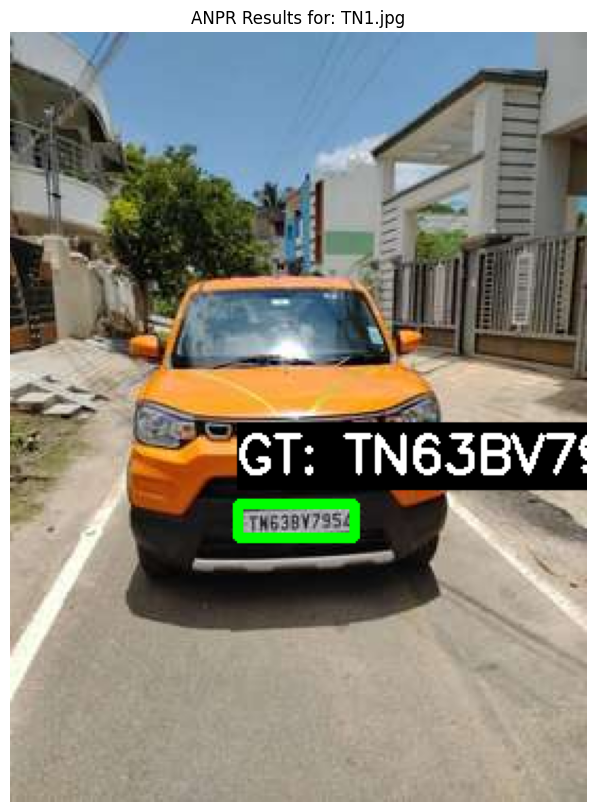

Detailed Recognition Results for this image:
  - Ground Truth: 'TN63BV7954'
  - Recognized  : 'T46794795'
  - Status      : MISMATCH
  - CER         : 0.50
------------------------------

--- Displaying Image 2/20: video3_1970.jpg ---


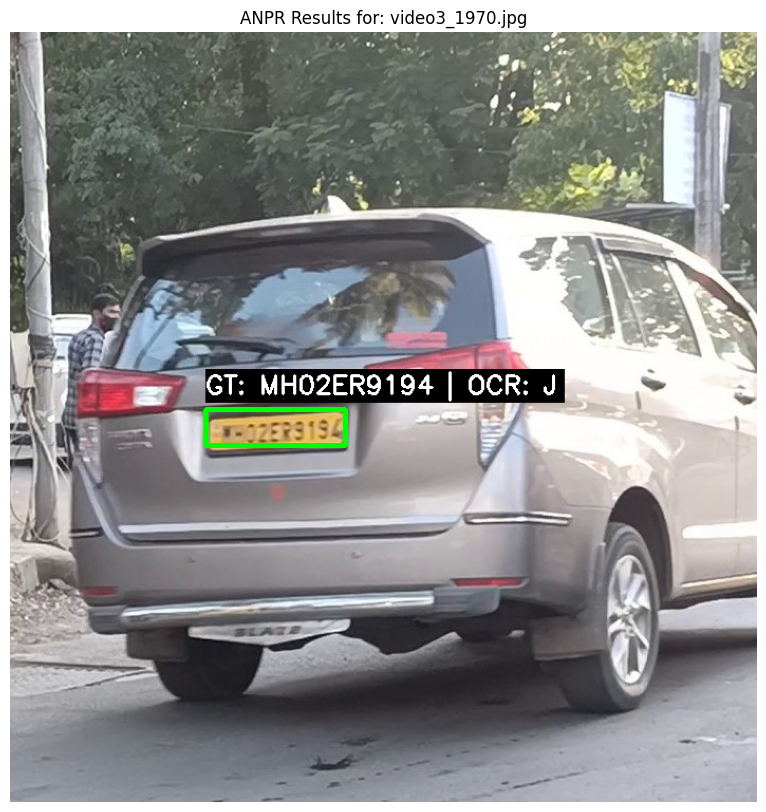

Detailed Recognition Results for this image:
  - Ground Truth: 'MH02ER9194'
  - Recognized  : 'J'
  - Status      : MISMATCH
  - CER         : 1.00
------------------------------

--- Displaying Image 3/20: video6_1090.jpg ---


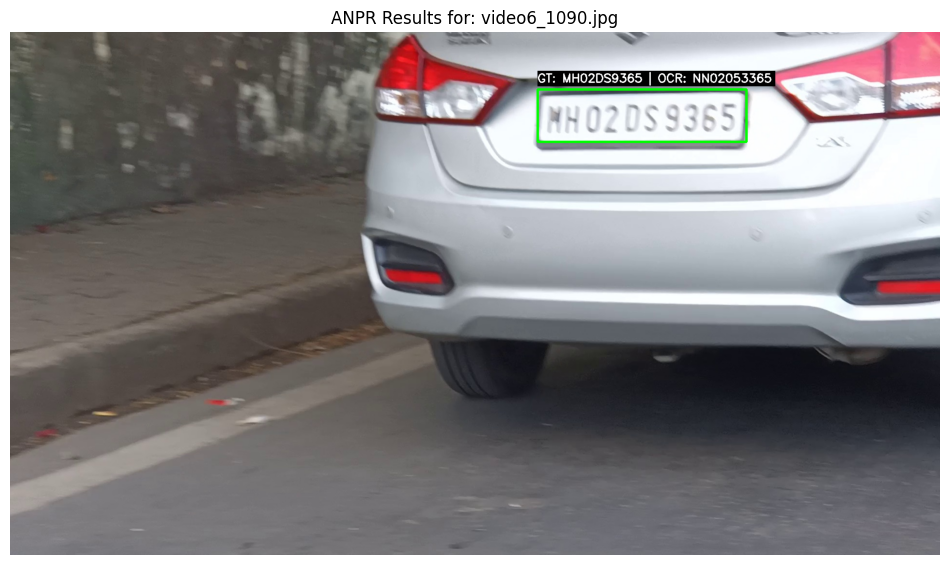

Detailed Recognition Results for this image:
  - Ground Truth: 'MH02DS9365'
  - Recognized  : 'NN02053365'
  - Status      : MISMATCH
  - CER         : 0.50
------------------------------

--- Displaying Image 4/20: video3_1980.jpg ---


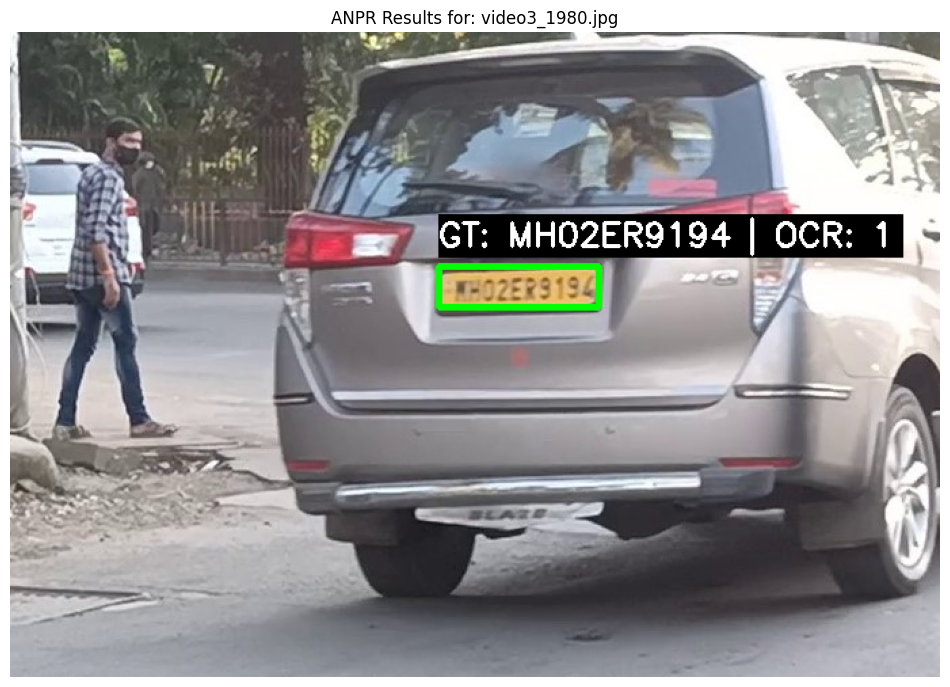

Detailed Recognition Results for this image:
  - Ground Truth: 'MH02ER9194'
  - Recognized  : '1'
  - Status      : MISMATCH
  - CER         : 0.90
------------------------------

--- Displaying Image 5/20: video2_4080.jpg ---


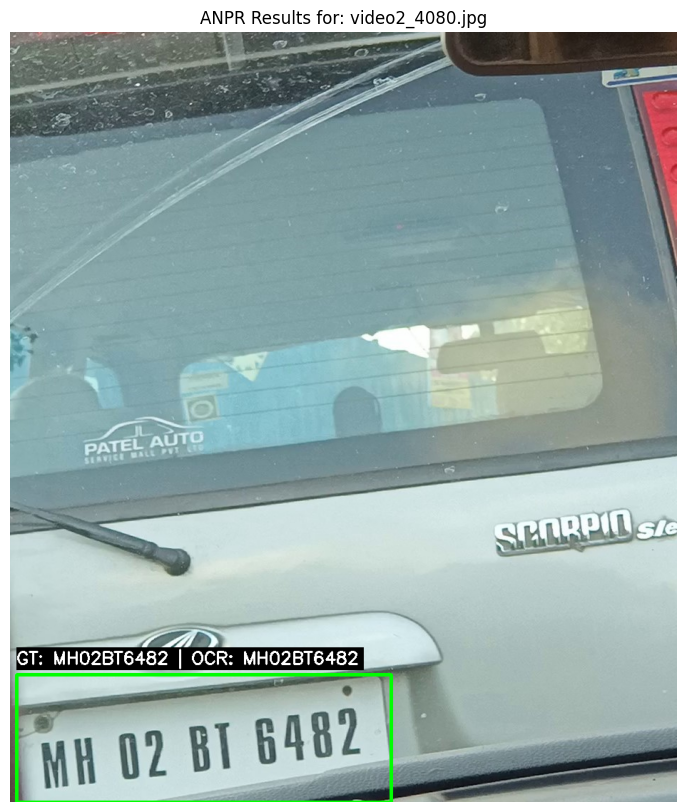

Detailed Recognition Results for this image:
  - Ground Truth: 'MH02BT6482'
  - Recognized  : 'MH02BT6482'
  - Status      : EXACT MATCH
------------------------------

--- Displaying Image 6/20: video8_1450.jpg ---


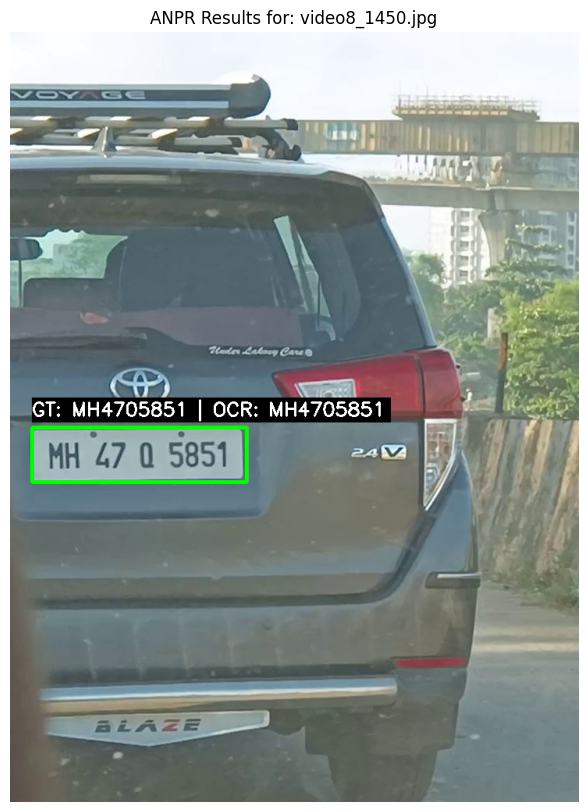

Detailed Recognition Results for this image:
  - Ground Truth: 'MH4705851'
  - Recognized  : 'MH4705851'
  - Status      : EXACT MATCH
------------------------------

--- Displaying Image 7/20: video4_2430.jpg ---


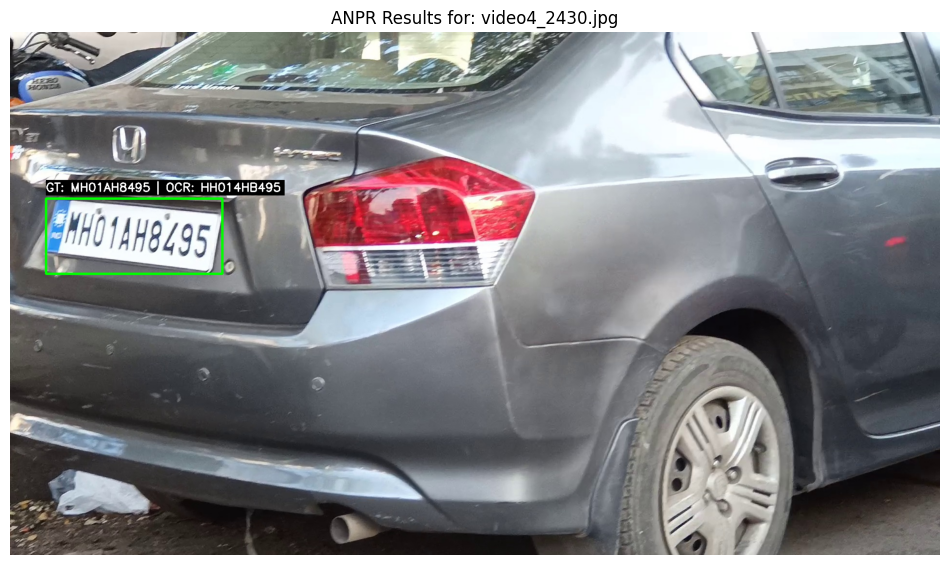

Detailed Recognition Results for this image:
  - Ground Truth: 'MH01AH8495'
  - Recognized  : 'HH014HB495'
  - Status      : MISMATCH
  - CER         : 0.30
------------------------------

--- Displaying Image 8/20: video3_1140.jpg ---


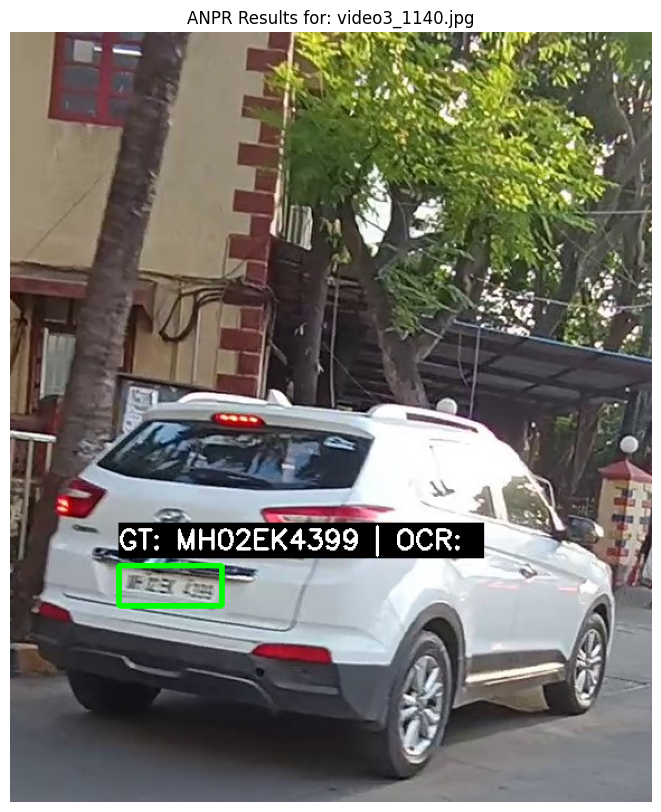

Detailed Recognition Results for this image:
  - Ground Truth: 'MH02EK4399'
  - Recognized  : ''
  - Status      : MISMATCH
  - CER         : 1.00
------------------------------

--- Displaying Image 9/20: video3_1120.jpg ---


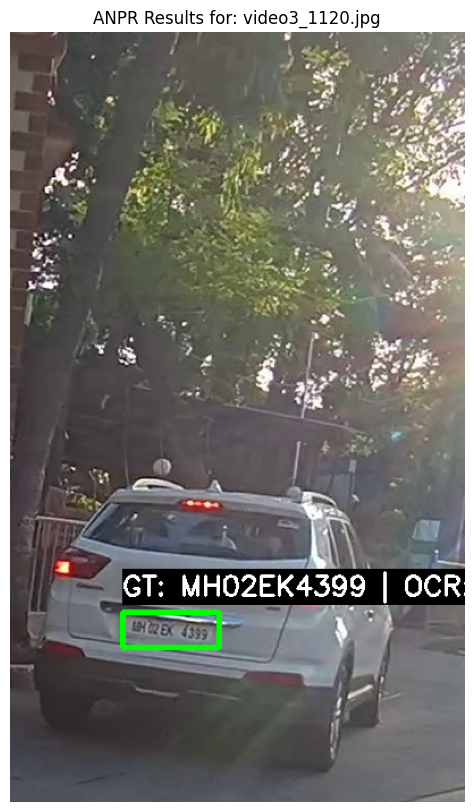

Detailed Recognition Results for this image:
  - Ground Truth: 'MH02EK4399'
  - Recognized  : '4J59Q8'
  - Status      : MISMATCH
  - CER         : 1.00
------------------------------

--- Displaying Image 10/20: video8_2450.jpg ---


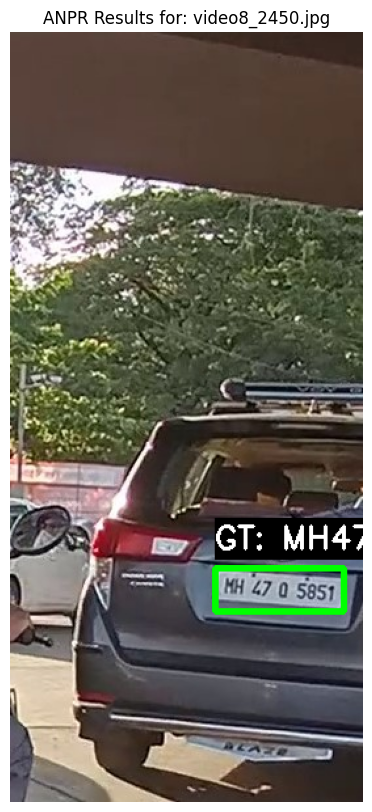

Detailed Recognition Results for this image:
  - Ground Truth: 'MH4705851'
  - Recognized  : 'LKHT2705851'
  - Status      : MISMATCH
  - CER         : 0.44
------------------------------

--- Displaying Image 11/20: video2_4870.jpg ---


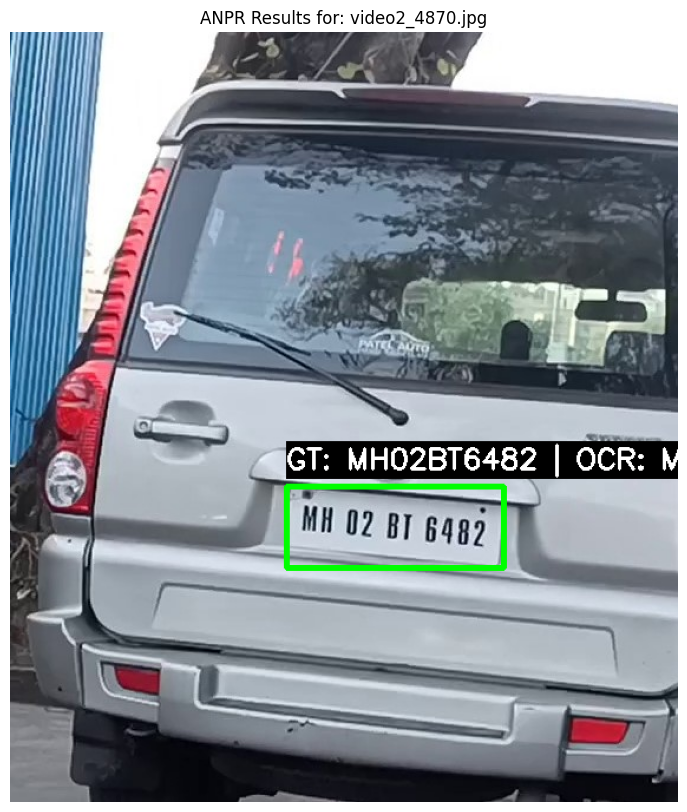

Detailed Recognition Results for this image:
  - Ground Truth: 'MH02BT6482'
  - Recognized  : 'MH02BT6482'
  - Status      : EXACT MATCH
------------------------------

--- Displaying Image 12/20: video5_1840.jpg ---


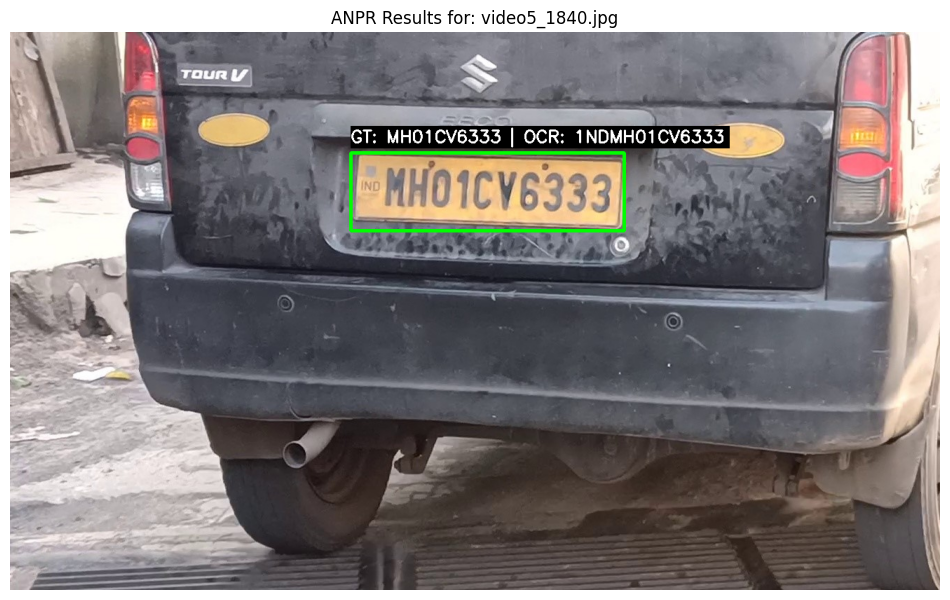

Detailed Recognition Results for this image:
  - Ground Truth: 'MH01CV6333'
  - Recognized  : '1NDMH01CV6333'
  - Status      : MISMATCH
  - CER         : 0.30
------------------------------

--- Displaying Image 13/20: video3_2250.jpg ---


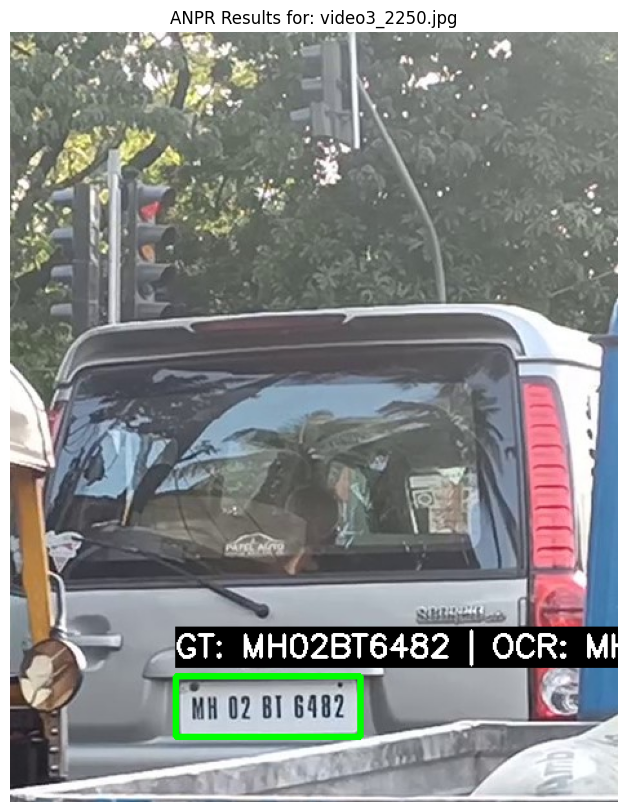

Detailed Recognition Results for this image:
  - Ground Truth: 'MH02BT6482'
  - Recognized  : 'MH02BT6482'
  - Status      : EXACT MATCH
------------------------------

--- Displaying Image 14/20: video10_1280.jpg ---


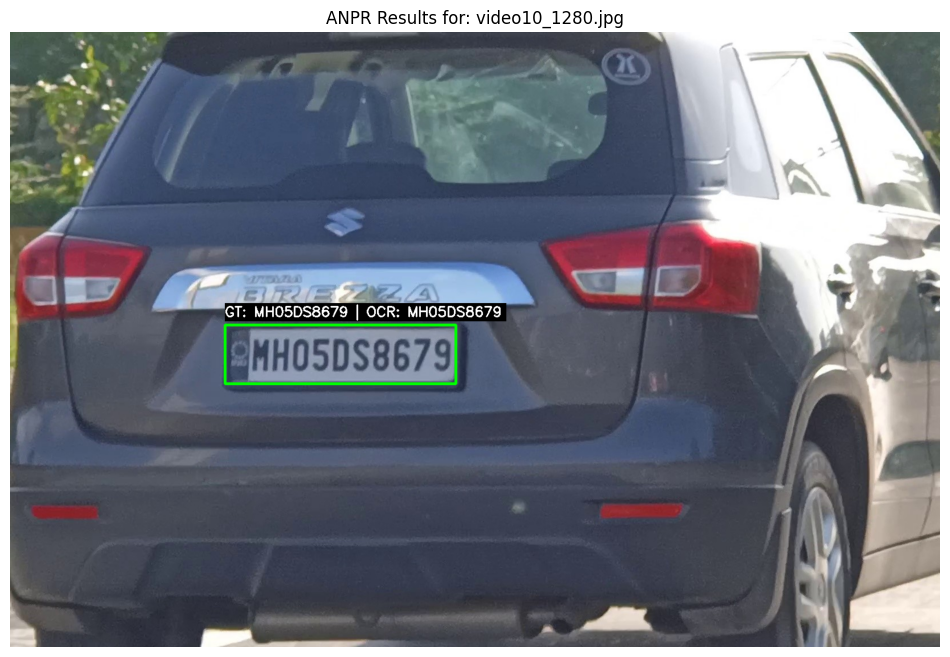

Detailed Recognition Results for this image:
  - Ground Truth: 'MH05DS8679'
  - Recognized  : 'MH05DS8679'
  - Status      : EXACT MATCH
------------------------------

--- Displaying Image 15/20: video11_2000.jpg ---


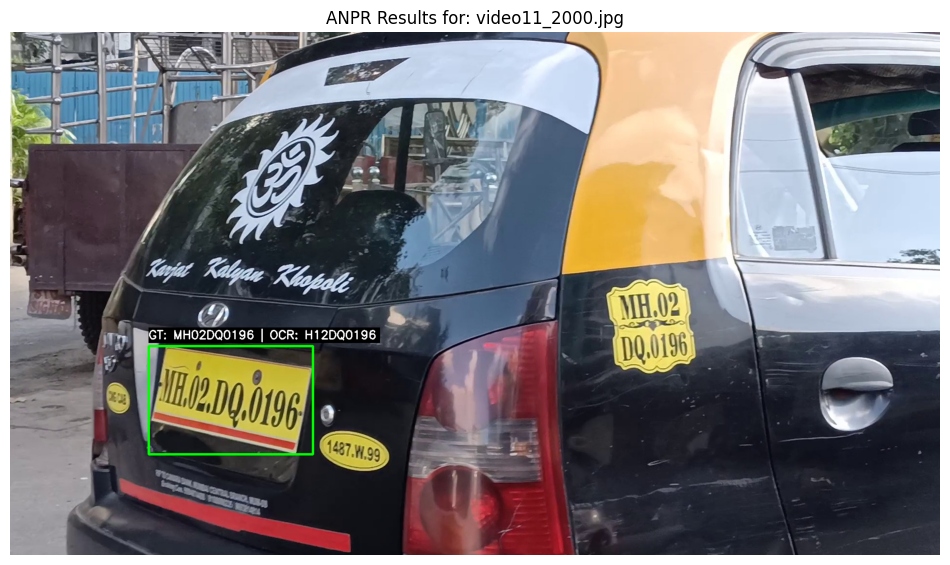

Detailed Recognition Results for this image:
  - Ground Truth: 'MH02DQ0196'
  - Recognized  : 'H12DQ0196'
  - Status      : MISMATCH
  - CER         : 0.20
------------------------------

--- Displaying Image 16/20: video2_2220.jpg ---


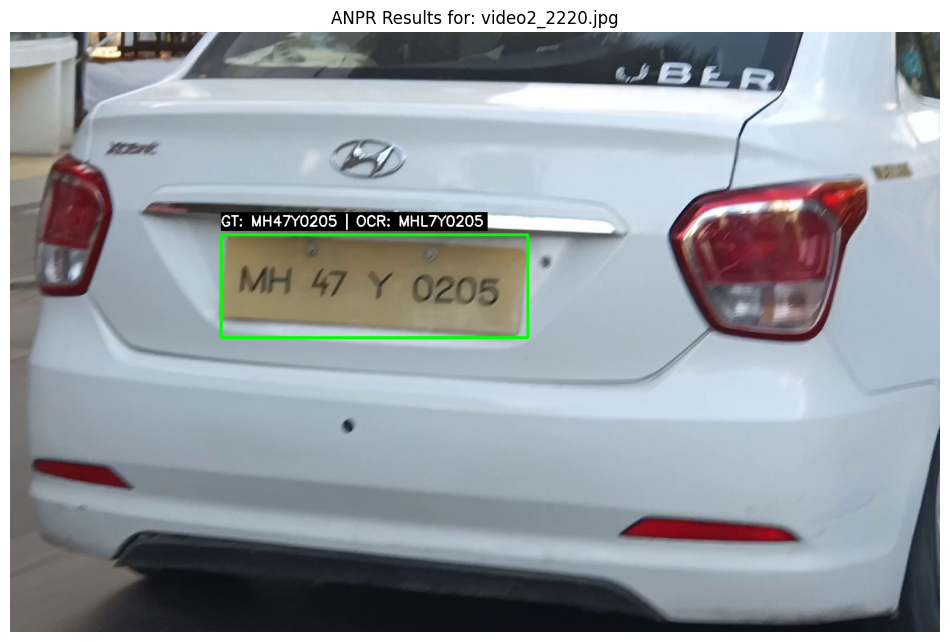

Detailed Recognition Results for this image:
  - Ground Truth: 'MH47Y0205'
  - Recognized  : 'MHL7Y0205'
  - Status      : MISMATCH
  - CER         : 0.11
------------------------------

--- Displaying Image 17/20: video11_3710.jpg ---


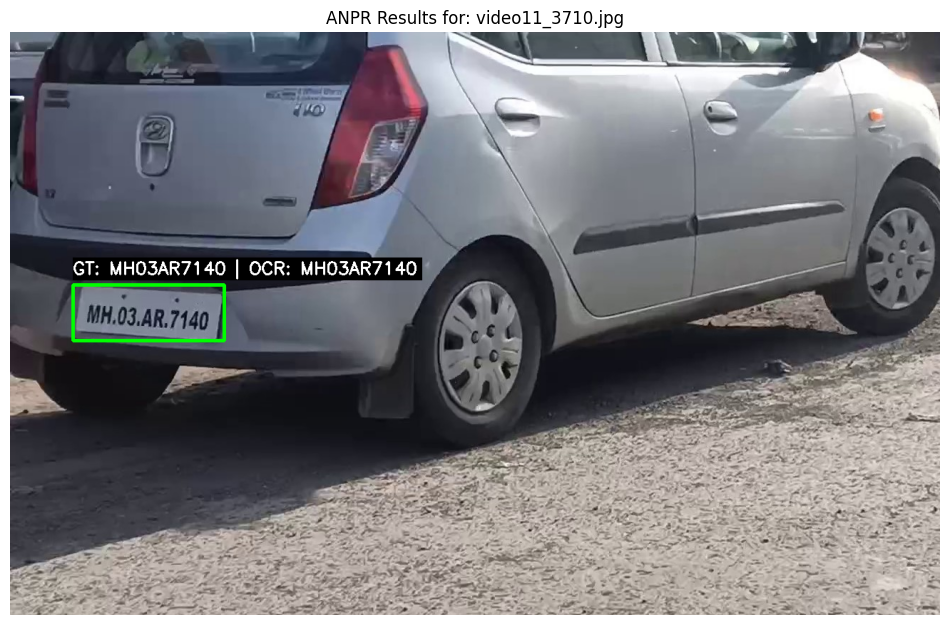

Detailed Recognition Results for this image:
  - Ground Truth: 'MH03AR7140'
  - Recognized  : 'MH03AR7140'
  - Status      : EXACT MATCH
------------------------------

--- Displaying Image 18/20: video8_920.jpg ---


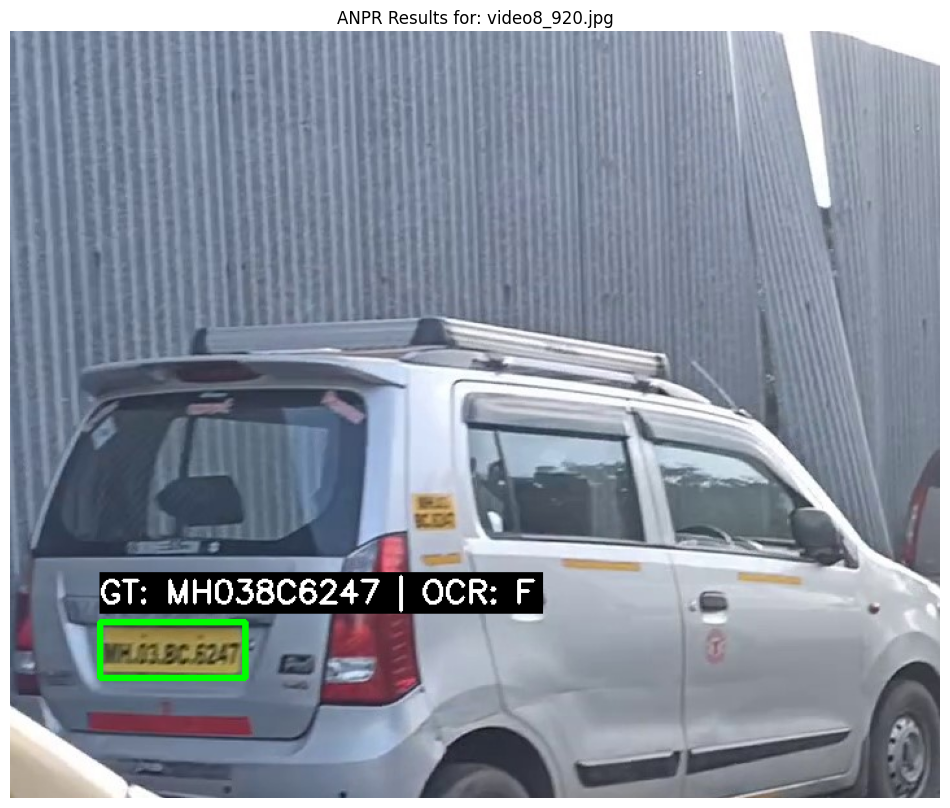

Detailed Recognition Results for this image:
  - Ground Truth: 'MH038C6247'
  - Recognized  : 'F'
  - Status      : MISMATCH
  - CER         : 1.00
------------------------------

--- Displaying Image 19/20: video5_130.jpg ---


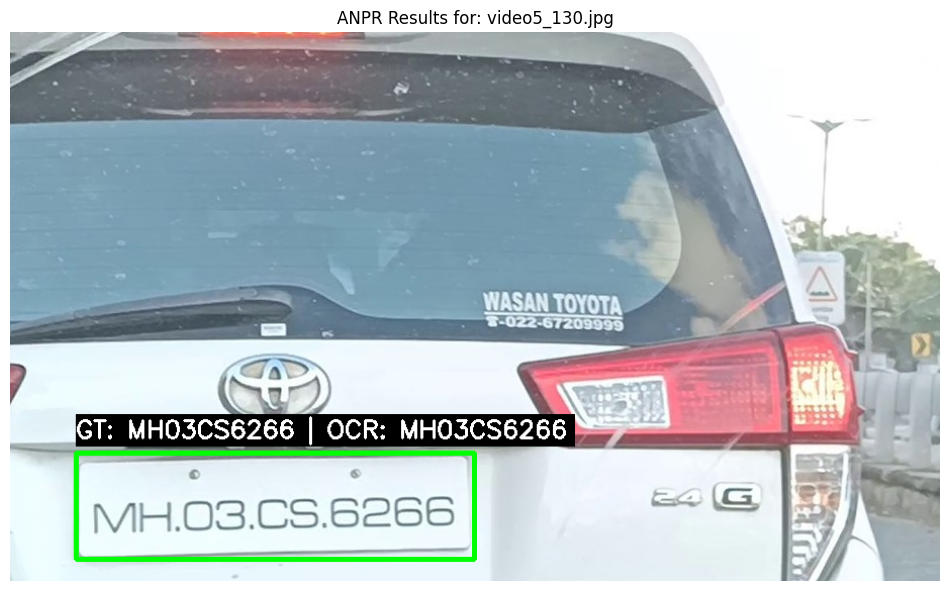

Detailed Recognition Results for this image:
  - Ground Truth: 'MH03CS6266'
  - Recognized  : 'MH03CS6266'
  - Status      : EXACT MATCH
------------------------------

--- Displaying Image 20/20: video5_100.jpg ---


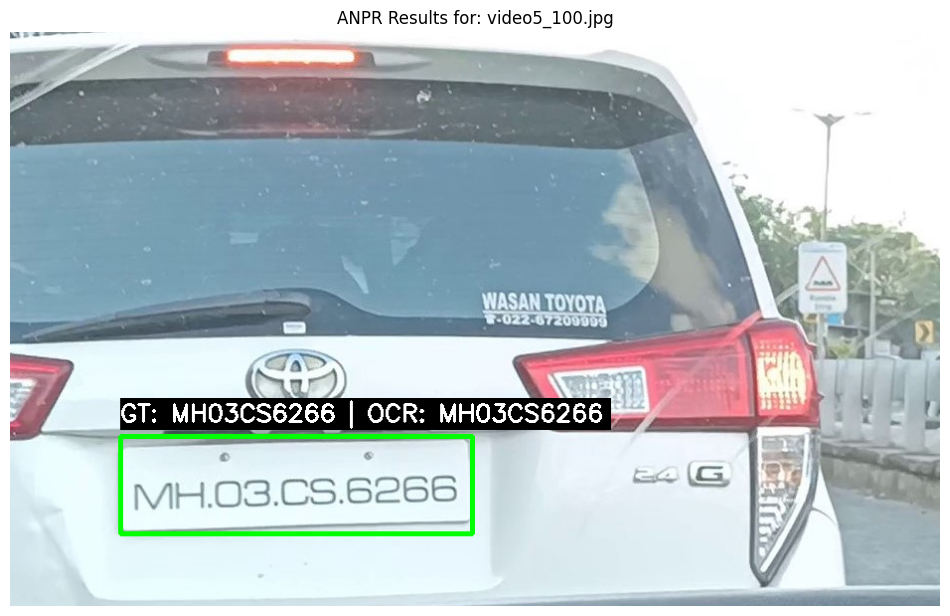

Detailed Recognition Results for this image:
  - Ground Truth: 'MH03CS6266'
  - Recognized  : 'MH03CS6266'
  - Status      : EXACT MATCH
------------------------------

--- Visual Demonstration Loop Complete ---

--- Collecting all data for comprehensive evaluation (up to 500 images) ---
Collected 496 OCR pairs for evaluation.


In [40]:
# Cell 6: Expanded Sample Processing with Evaluation Data Collection

import cv2
import matplotlib.pyplot as plt
import numpy as np
import random
from Levenshtein import distance as levenshtein_distance # For CER calculation
import collections # To count common misrecognitions (optional)

# Ensure all_image_data list is populated from Cell 2
if 'all_image_data' not in locals() or not all_image_data:
    print("Error: 'all_image_data' not found or is empty. Please run Cell 2 first.")
    exit() # Exit if no data, or handle gracefully in a live environment
else:
    print(f"Proceeding with {len(all_image_data)} annotated images from Cell 2 for potential evaluation.")

# --- Configuration for Demo Samples ---
num_demo_images_for_display = 20 # Process this many for visual demo
num_images_for_evaluation = min(len(all_image_data), 500) # Use up to 100 images for evaluation, or all if less

# Select a subset of images for visual demonstration
if len(all_image_data) > num_demo_images_for_display:
    demo_images_for_display = random.sample(all_image_data, num_demo_images_for_display)
else:
    demo_images_for_display = all_image_data # Use all if less than num_demo_images_for_display

print(f"\nProcessing {len(demo_images_for_display)} randomly selected images for visual demonstration.")

# --- Data structures to store results for evaluation ---
ocr_results_for_evaluation = [] # Stores {'ground_truth': str, 'recognized': str} for each plate
detection_results_for_evaluation = [] # Stores {'iou': float} for each detected plate (will be 1.0 here)

# --- Main processing loop for visual demo ---
print("\n--- Visual Demonstration Loop ---")
for i, image_info in enumerate(demo_images_for_display):
    image_path = image_info['image_path']
    ground_truth_annotations = image_info['annotations']

    print(f"\n--- Displaying Image {i+1}/{len(demo_images_for_display)}: {os.path.basename(image_path)} ---")

    original_img = cv2.imread(image_path)
    if original_img is None:
        print(f"Error: Could not load image from {image_path}. Skipping.")
        continue

    display_img = original_img.copy()
    img_height, img_width, _ = display_img.shape

    processed_plates_details = []

    for gt_ann in ground_truth_annotations:
        gt_box = gt_ann['box']
        gt_plate_text = gt_ann['name'].upper() # Convert GT to uppercase for consistent comparison

        xmin, ymin, xmax, ymax = gt_box

        xmin = max(0, xmin)
        ymin = max(0, ymin)
        xmax = min(img_width, xmax)
        ymax = min(img_height, ymax)

        width = xmax - xmin
        height = ymax - ymin

        if width <= 10 or height <= 10:
            print(f"Warning: Ground truth bounding box for plate '{gt_plate_text}' is too small or invalid ({gt_box}). Skipping for OCR.")
            continue

        cropped_plate_region = original_img[ymin:ymax, xmin:xmax]

        if cropped_plate_region.size == 0:
            print(f"Warning: Cropped region for ground truth plate '{gt_plate_text}' is empty. Skipping for OCR.")
            continue

        recognized_text = recognize_characters(cropped_plate_region)

        # Store results for later full evaluation
        ocr_results_for_evaluation.append({
            'ground_truth': gt_plate_text,
            'recognized': recognized_text
        })
        # For detection, since we are using GT, IoU is 1.0 (perfect detection)
        detection_results_for_evaluation.append({'iou': 1.0})

        # --- Visuals ---
        cv2.rectangle(display_img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 3) # Green box for GT

        display_text = f"GT: {gt_plate_text} | OCR: {recognized_text}"

        (text_width, text_height), baseline = cv2.getTextSize(display_text, cv2.FONT_HERSHEY_SIMPLEX, 0.8, 2)

        text_x = xmin
        text_y = ymin - 15 if ymin - 15 > text_height else ymin + text_height + 5

        cv2.rectangle(display_img, (text_x, text_y - text_height - 5), (text_x + text_width + 5, text_y + baseline), (0, 0, 0), -1)
        cv2.putText(display_img, display_text, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 255, 255), 2)

        processed_plates_details.append({
            'ground_truth': gt_plate_text,
            'recognized': recognized_text
        })


    plt.figure(figsize=(12, 10))
    plt.imshow(cv2.cvtColor(display_img, cv2.COLOR_BGR2RGB))
    plt.title(f"ANPR Results for: {os.path.basename(image_path)}")
    plt.axis('off')
    plt.show()

    if processed_plates_details:
        print("Detailed Recognition Results for this image:")
        for plate_data in processed_plates_details:
            print(f"  - Ground Truth: '{plate_data['ground_truth']}'")
            print(f"  - Recognized  : '{plate_data['recognized']}'")
            if plate_data['ground_truth'].upper() == plate_data['recognized'].upper():
                print("  - Status      : EXACT MATCH")
            else:
                print("  - Status      : MISMATCH")
                if len(plate_data['ground_truth']) > 0:
                    dist = levenshtein_distance(plate_data['ground_truth'].upper(), plate_data['recognized'].upper())
                    cer = dist / len(plate_data['ground_truth'])
                    print(f"  - CER         : {cer:.2f}")
                else:
                    print("  - CER         : N/A (Ground truth is empty)")
            print("-" * 30)
    else:
        print("No processable license plates in this image.")

print("\n--- Visual Demonstration Loop Complete ---")

# --- Now, collect all results for evaluation (beyond just the visual demo subset) ---
print(f"\n--- Collecting all data for comprehensive evaluation (up to {num_images_for_evaluation} images) ---")
all_ocr_evaluation_pairs = []
all_detection_evaluation_ious = []

# To avoid re-processing the demo images, we can either exclude them or just re-run over a larger random sample.
# For simplicity, let's select a new random sample for comprehensive evaluation up to num_images_for_evaluation
# to ensure we capture a representative set without too much runtime.
evaluation_images = random.sample(all_image_data, num_images_for_evaluation)

for i, image_info in enumerate(evaluation_images):
    image_path = image_info['image_path']
    ground_truth_annotations = image_info['annotations']

    original_img = cv2.imread(image_path)
    if original_img is None:
        continue # Skip if image cannot be loaded

    img_height, img_width, _ = original_img.shape

    for gt_ann in ground_truth_annotations:
        gt_box = gt_ann['box']
        gt_plate_text = gt_ann['name'].upper()

        xmin, ymin, xmax, ymax = gt_box

        xmin = max(0, xmin)
        ymin = max(0, ymin)
        xmax = min(img_width, xmax)
        ymax = min(img_height, ymax)

        width = xmax - xmin
        height = ymax - ymin

        if width <= 10 or height <= 10:
            continue

        cropped_plate_region = original_img[ymin:ymax, xmin:xmax]

        if cropped_plate_region.size == 0:
            continue

        recognized_text = recognize_characters(cropped_plate_region)

        all_ocr_evaluation_pairs.append({
            'ground_truth': gt_plate_text,
            'recognized': recognized_text
        })
        all_detection_evaluation_ious.append(1.0) # IoU is 1.0 since we are using GT boxes

print(f"Collected {len(all_ocr_evaluation_pairs)} OCR pairs for evaluation.")

# EVALUATING THE MODEL

For OCR, we'll calculate metrics like Exact Match Accuracy and Character Error Rate (CER) by comparing EasyOCR's output directly against the ground truth license plate numbers provided in the dataset's XML annotations.

For Detection, it's crucial to remember that in this specific demonstration, we've used the ground truth bounding boxes from the XML files to precisely crop the license plates. This simulates a "perfect" detection scenario, allowing us to isolate and evaluate the OCR's performance effectively. In a real-world deployed system, a separate, fine-tuned object detection model (like YOLOv8) would be responsible for this initial detection step, and its performance would be evaluated using metrics like Intersection over Union (IoU), Precision, Recall, and Mean Average Precision (mAP). We'll discuss these theoretical aspects of detection evaluation here.

Let's dive into the numbers!




--- Evaluating Model Performance ---

--- OCR (Character Recognition) Performance ---
Total Plates Evaluated: 496
Exact Matches: 110
Exact Match Accuracy: 22.18%
Total Ground Truth Characters: 4894
Total Character Errors (Levenshtein Distance): 1683
Character Error Rate (CER): 34.39%

Common OCR Mismatches:
  GT: 'MH43AL8464' -> Rec: ''
  GT: 'MH01AX3070' -> Rec: 'G0014X3070'
  GT: 'MH02EU4077' -> Rec: '1202D4074'
  GT: 'MH01JA8939' -> Rec: 'HF01J4649'
  GT: 'MH01AU0059' -> Rec: 'WH01AV00SC'
  GT: 'MH01AU0059' -> Rec: 'HH0LAV0059'
  GT: 'MH01BU1852' -> Rec: 'BUHH0X1852'
  GT: 'MH4705851' -> Rec: 'M4T4705851'
  GT: 'MH01AV7461' -> Rec: 'YMH0LAV74610'
  GT: 'MH03BS4060' -> Rec: 'HH03BS4060'
  ... (376 more mismatches not displayed)


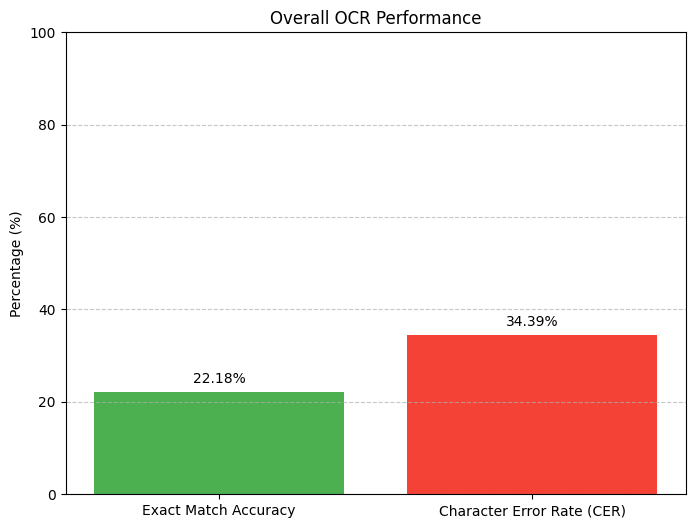


--- Detection Performance (Simulated) ---
Important Note: In this demonstration, we are using the ground truth bounding boxes
directly for cropping the license plates. This simulates a 'perfect' detection step.
Therefore, traditional detection metrics like mAP, Precision, Recall, and IoU
cannot be calculated for a trained detection model here.
If we were to calculate IoU for the ground truth boxes against themselves, it would always be 1.0.

Total Plates 'Detected' (via Ground Truth): 496
Average IoU (using Ground Truth boxes): 1.00 (always 1.0 in this setup)

How to Evaluate Detection in a Real System:
1.  Intersection over Union (IoU): Measures the overlap between a predicted bounding box and the ground truth box. Typically, an IoU threshold (e.g., 0.5 or 0.75) is used to determine if a prediction is 'correct'.
2.  Precision: Out of all predicted bounding boxes, how many were correct?
3.  Recall: Out of all actual ground truth bounding boxes, how many were correctly detected?
4.  F1

In [41]:
# Cell 6: Evaluation Metrics, Stats, and Visualizations

import matplotlib.pyplot as plt
import numpy as np
import collections
from Levenshtein import distance as levenshtein_distance

print("\n--- Evaluating Model Performance ---")

# --- 1. OCR Performance Metrics ---
print("\n--- OCR (Character Recognition) Performance ---")

total_plates = len(all_ocr_evaluation_pairs)
if total_plates == 0:
    print("No OCR results to evaluate. Please ensure data collection in Cell 6 was successful.")
else:
    exact_matches = 0
    total_gt_chars = 0
    total_errors = 0

    # Store common misrecognitions
    misrecognitions_list = []

    for pair in all_ocr_evaluation_pairs:
        gt = pair['ground_truth'].upper()
        rec = pair['recognized'].upper()

        if gt == rec:
            exact_matches += 1

        total_gt_chars += len(gt)
        total_errors += levenshtein_distance(gt, rec)

        if gt != rec:
            misrecognitions_list.append({'gt': gt, 'rec': rec})

    # Calculate Metrics
    exact_match_accuracy = (exact_matches / total_plates) * 100

    # Character Error Rate (CER)
    # If total_gt_chars is 0 (e.g., all GTs are empty strings), handle division by zero
    cer = (total_errors / total_gt_chars) * 100 if total_gt_chars > 0 else float('inf')

    print(f"Total Plates Evaluated: {total_plates}")
    print(f"Exact Matches: {exact_matches}")
    print(f"Exact Match Accuracy: {exact_match_accuracy:.2f}%")
    print(f"Total Ground Truth Characters: {total_gt_chars}")
    print(f"Total Character Errors (Levenshtein Distance): {total_errors}")
    print(f"Character Error Rate (CER): {cer:.2f}%")

    # --- Common Misrecognitions (Optional Visualization) ---
    print("\nCommon OCR Mismatches:")
    # You might want to sample these if misrecognitions_list is too long
    num_display_mismatches = min(10, len(misrecognitions_list))
    for j in range(num_display_mismatches):
        print(f"  GT: '{misrecognitions_list[j]['gt']}' -> Rec: '{misrecognitions_list[j]['rec']}'")
    if len(misrecognitions_list) > num_display_mismatches:
        print(f"  ... ({len(misrecognitions_list) - num_display_mismatches} more mismatches not displayed)")

    # --- Visualizations for OCR ---
    labels = ['Exact Match Accuracy', 'Character Error Rate (CER)']
    values = [exact_match_accuracy, cer]
    colors = ['#4CAF50', '#F44336'] # Green for accuracy, Red for errors

    plt.figure(figsize=(8, 6))
    plt.bar(labels, values, color=colors)
    plt.ylim(0, 100)
    plt.ylabel('Percentage (%)')
    plt.title('Overall OCR Performance')
    for index, value in enumerate(values):
        plt.text(index, value + 2, f"{value:.2f}%", ha='center')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

# --- 2. Detection Performance Metrics ---
print("\n--- Detection Performance (Simulated) ---")
print("Important Note: In this demonstration, we are using the ground truth bounding boxes")
print("directly for cropping the license plates. This simulates a 'perfect' detection step.")
print("Therefore, traditional detection metrics like mAP, Precision, Recall, and IoU")
print("cannot be calculated for a trained detection model here.")
print("If we were to calculate IoU for the ground truth boxes against themselves, it would always be 1.0.")

total_detections_evaluated = len(all_detection_evaluation_ious)
if total_detections_evaluated > 0:
    avg_iou = np.mean(all_detection_evaluation_ious)
    print(f"\nTotal Plates 'Detected' (via Ground Truth): {total_detections_evaluated}")
    print(f"Average IoU (using Ground Truth boxes): {avg_iou:.2f} (always 1.0 in this setup)")
else:
    print("No detection results to evaluate.")

print("\nHow to Evaluate Detection in a Real System:")
print("1.  Intersection over Union (IoU): Measures the overlap between a predicted bounding box and the ground truth box. Typically, an IoU threshold (e.g., 0.5 or 0.75) is used to determine if a prediction is 'correct'.")
print("2.  Precision: Out of all predicted bounding boxes, how many were correct?")
print("3.  Recall: Out of all actual ground truth bounding boxes, how many were correctly detected?")
print("4.  F1-Score: The harmonic mean of Precision and Recall, balancing both.")
print("5.  Mean Average Precision (mAP): The most common metric for object detection. It averages the Average Precision (AP) over all classes (or just 'license_plate' in our case) and across different IoU thresholds. A higher mAP indicates better detection performance.")
print("To calculate these, a YOLO model would need to be trained on the dataset, and its predictions would be compared against the ground truth annotations.")

# --- 3. Overall Pipeline Performance ---
print("\n--- Overall ANPR Pipeline Performance ---")
print("The overall performance of the ANPR system depends on the synergy of both detection and recognition.")
print("Since we used ground truth for detection, the bottleneck here is primarily OCR performance.")
print(f"Based on OCR Exact Match Accuracy: {exact_match_accuracy:.2f}% of plates were fully recognized correctly (assuming perfect detection).")
print(f"Based on OCR Character Error Rate (CER): {cer:.2f}% indicates the average error at a character level.")

print("\n--- Evaluation Complete ---")
print("This evaluation highlights the current OCR accuracy and the need for a trained detection model in a production system.")